# Annotation QA and exploration
This notebook is not meant to be published.  
It is only used to explore annotation QA metrics in order to try and find a formula for filtering low quality gene models.

In [1]:
import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt

In [1]:
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
#import plotly.figure_factory as ff
import plotly.graph_objs as go

Start by loading a table with QA metrics resulting from running the QA script on my annotation of the Heinz reference. File is at:
/groups/itay_mayrose/liorglic/Projects/tomato_pan_genome/output/annotation_manual_experiment/S_lycopersicum_chromosomes.3.00.maker.output/annotation_QA_report.tsv

In [3]:
in_tsv = "/groups/itay_mayrose/liorglic/Projects/tomato_pan_genome/output/annotation_manual_experiment/S_lycopersicum_chromosomes.3.00.maker.output/annotation_QA_report.tsv"
qa_df = pd.read_csv(in_tsv, sep='\t')
qa_df["UTR"] = qa_df["UTR"].astype('category')

In [5]:
qa_df.head()

,gene,AED,UTR,Repeats,BUSCO,BLAST,IPS
0,Solyc00g005040.3.1,0.16,2,16.163285,NaN,87.0,6.420000e-22
1,Solyc00g005050.3.1,0.11,2,4.419116,NaN,NaN,4.240000e-18
2,Solyc00g005060.1.1,0.00,0,0.000000,NaN,NaN,NaN
3,Solyc00g005080.2.1,0.11,0,2.439024,NaN,85.0,NaN
4,Solyc00g005090.1.1,0.00,0,0.000000,NaN,NaN,NaN


In [7]:
# Get some basic stats
qa_df.describe(include=[np.number, 'category'])

,AED,UTR,Repeats,BLAST,IPS
count,36218.000000,36218.0,36218.000000,22257.000000,2.422200e+04
unique,NaN,3.0,NaN,NaN,NaN
top,NaN,2.0,NaN,NaN,NaN
freq,NaN,17617.0,NaN,NaN,NaN
mean,0.240177,NaN,8.980372,83.794581,1.654709e-05
std,0.193601,NaN,15.715831,21.155711,8.958352e-04
min,0.000000,NaN,0.000000,3.000000,0.000000e+00
25%,0.080000,NaN,0.000000,77.000000,5.757500e-70
50%,0.190000,NaN,2.700266,94.000000,3.030000e-35
75%,0.380000,NaN,10.202623,99.000000,3.770000e-18


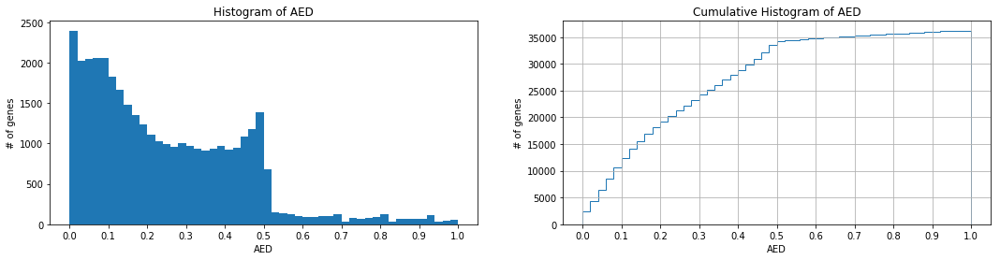

In [33]:
plt.figure(figsize=(18,4))
plt.subplot(1, 2, 1)
# General distribution of AED
aed_hist = plt.hist(qa_df["AED"], bins=50)
plt.title("Histogram of AED")
plt.xlabel("AED")
plt.ylabel("# of genes")
plt.xticks(np.linspace(0,1,11));
# cumulative
plt.subplot(1, 2, 2)
aed_cumul = plt.hist(qa_df["AED"], bins=50, cumulative=True, histtype='step')
plt.title("Cumulative Histogram of AED")
plt.xlabel("AED")
plt.ylabel("# of genes")
plt.xticks(np.linspace(0,1,11))
plt.grid();

In [52]:
aed_no_busco = go.Histogram(x=qa_df.loc[qa_df['BUSCO'].isnull()]['AED'],
                            name="Non BUSCO", histnorm="percent",
                            opacity=0.5)
aed_busco = go.Histogram(x=qa_df.loc[qa_df['BUSCO'].notnull()]['AED'],
                         name="BUSCO", histnorm="percent",
                         opacity=0.5)
data = [aed_no_busco, aed_busco]

layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="% of genes"),
                   title="Histogram of AED - BUSCO vs. Non-BUSCO", 
                  )
fig = go.Figure(data=data, layout=layout)
iplot(fig)


Note that there are zero BUSCO genes with AED > 0.5

In [53]:
aed_no_ips = go.Histogram(x=qa_df.loc[qa_df['IPS'].isnull()]['AED'],
                            name="Non IPS", histnorm="percent",
                            opacity=0.5)
aed_ips = go.Histogram(x=qa_df.loc[qa_df['IPS'].notnull()]['AED'],
                         name="IPS", histnorm="percent",
                         opacity=0.5)
data = [aed_no_ips, aed_ips]

layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="% of genes"),
                   title="Histogram of AED - IPS vs. Non-IPS", 
                  )
fig = go.Figure(data=data, layout=layout)
iplot(fig)

Looks like both BUSCO and IPS are good indicators of quality, as there are less genes with BUSCO and IPS with high AED.  
Let's see if a similar trend occurs for a non-reference variant - in this case Moneymaker.

In [5]:
mm_tsv = "/groups/itay_mayrose/liorglic/Projects/tomato_pan_genome/output/genome_annotation/annotation_results/per_sample/la2706__ver100/Annotation_QA/la2706__ver100.QA_report.tsv"
mm_qa_df = pd.read_csv(mm_tsv, sep='\t')
mm_qa_df["UTR"] = mm_qa_df["UTR"].astype('category')

In [14]:
mm_qa_df.head()

,gene,AED,UTR,Repeats,BUSCO,BLAST,IPS
0,augustus-10000001_0_2776950-processed-gene-0.4...,0.14,0,5.948553,NaN,NaN,NaN
1,augustus-10000001_0_2776950-processed-gene-0.5...,0.48,0,100.000000,NaN,97.0,NaN
2,augustus-10000001_0_2776950-processed-gene-0.5...,0.49,0,100.000000,NaN,93.0,4.500000e-34
3,augustus-10000001_0_2776950-processed-gene-0.5...,0.48,0,90.394877,NaN,87.0,3.410000e-16
4,augustus-10000001_0_2776950-processed-gene-0.5...,0.48,0,100.000000,NaN,84.0,2.440000e-06


In [55]:
mm_qa_df.describe(include=[np.number, 'category'])

,AED,UTR,Repeats,BUSCO,BLAST,IPS
count,41001.000000,41001.0,41001.000000,2899.000000,21182.000000,2.388400e+04
unique,NaN,3.0,NaN,NaN,NaN,NaN
top,NaN,0.0,NaN,NaN,NaN,NaN
freq,NaN,22163.0,NaN,NaN,NaN,NaN
mean,0.322437,NaN,10.570171,14866.046223,82.353602,9.988646e-06
std,0.222986,NaN,19.227573,9983.483090,22.921643,6.498496e-04
min,0.000000,NaN,0.000000,1.000000,3.000000,0.000000e+00
25%,0.130000,NaN,0.000000,6260.500000,75.000000,1.127500e-69
50%,0.300000,NaN,1.867929,13742.000000,93.000000,9.455000e-36
75%,0.470000,NaN,10.661529,21895.000000,99.000000,2.000000e-18


In [58]:
ref_aed = go.Histogram(x=qa_df['AED'],
                      name="Heinz1706 Ref.",
                      histnorm="percent",
                      opacity=0.5)
mm_aed = go.Histogram(x=mm_qa_df['AED'],
                      name="Moneymaker",
                      histnorm="percent",
                     opacity=0.5)
layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="% of genes"),
                   title="Histogram of AED - Heinz vs. Moneymaker"
                  )
data = [ref_aed, mm_aed]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

The pattern is rather similar, but looks like Moneymaker is generally of lower quality.  
<font color='red'>What's the deal with the surge just before 0,5?</font> Is it some artifact of the way AED is calculated?

Let's take a look at histogram of % overlap with repeats.

In [8]:
ref_repeats = go.Histogram(x=qa_df['Repeats'],
                      name="Heinz1706 Ref.",
                      histnorm="percent",
                      opacity=0.5)
mm_repeats = go.Histogram(x=mm_qa_df['Repeats'],
                      name="Moneymaker",
                      histnorm="percent",
                     opacity=0.5)
layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="% overlap with repeats", dtick=5),
                   yaxis=dict(title="% of genes"),
                   title="Histogram of % of overlap with repeats - Heinz vs. Moneymaker"
                  )
data = [ref_repeats, mm_repeats]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

What if we only look at BUSCO genes?

In [13]:
ref_repeats = go.Histogram(x=qa_df.loc[qa_df['BUSCO'].notnull()]['Repeats'],
                      name="Heinz1706 Ref. - BUSCO genes",
                      histnorm="percent",
                      opacity=0.5)
mm_repeats = go.Histogram(x=mm_qa_df.loc[mm_qa_df['BUSCO'].notnull()]['Repeats'],
                      name="Moneymaker - BUSCO genes",
                      histnorm="percent",
                     opacity=0.5)
layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="% overlap with repeats", dtick=5),
                   yaxis=dict(title="% of genes"),
                   title="Histogram of % of overlap with repeats - Heinz vs. Moneymaker - only BUSCO genes"
                  )
data = [ref_repeats, mm_repeats]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

Text(0,0.5,'# of genes')

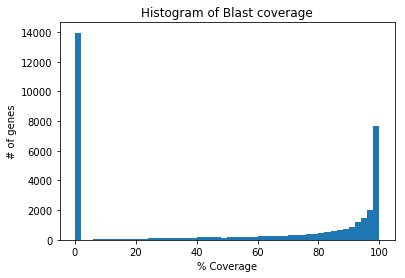

In [89]:
# histogram of BLAST coverage - convert NaN (no hit) to 0
qa_df['BLAST'] = qa_df['BLAST'].fillna(0)
blast_hist = plt.hist(qa_df["BLAST"], bins=50)
plt.title("Histogram of Blast coverage")
plt.xlabel("% Coverage")
plt.ylabel("# of genes")

Text(0,0.5,'BLAST coverage')

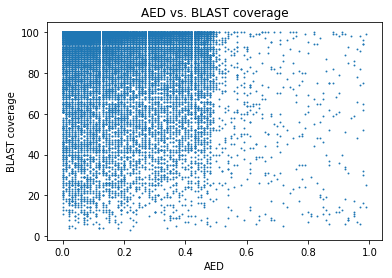

In [91]:
# correlation between AED and BLAST coverage (remove NaN coverage)
qa_df_blast = qa_df[qa_df.BLAST != 0]
scat = plt.scatter(qa_df_blast["AED"],qa_df_blast["BLAST"], s=.8)
plt.title("AED vs. BLAST coverage")
plt.xlabel("AED")
plt.ylabel("BLAST coverage")

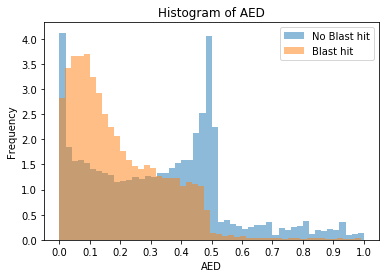

In [95]:
# split AED hist according to Blast coverage > 80
aed_hist_no_blast = plt.hist(qa_df[qa_df.BLAST < 0.8]["AED"], bins=50, label="No Blast hit", alpha=0.5, density=True)
aed_hist_blast = plt.hist(qa_df[qa_df.BLAST > 0.8]["AED"], bins=50, label="Blast hit", alpha=0.5, density=True)
plt.title("Histogram of AED")
plt.xlabel("AED")
plt.ylabel("Frequency")
plt.legend(loc='upper right')
plt.xticks(np.linspace(0,1,11));

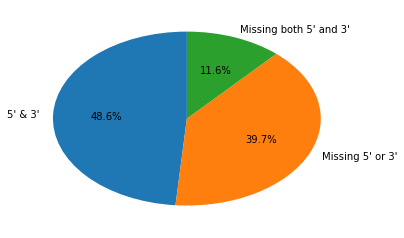

In [84]:
# pie plot of UTR status
utr_freq = qa_df["UTR"].value_counts()
utr_pie = plt.pie(utr_freq, labels=["5' & 3'", "Missing 5' or 3'", "Missing both 5' and 3'"], startangle=90, autopct='%1.1f%%')

================================================================================================

In [29]:
import pandas as pd
import numpy as np
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
#import plotly.figure_factory as ff
import plotly.graph_objs as go

In [62]:
in_tsv = "/groups/itay_mayrose/nosnap/liorglic/Projects/tomato_pan_genome/output/genome_annotation/annotation_results/per_sample/dixie_golden_giant_tr00020__ver100/Annotation_QA/dixie_golden_giant_tr00020__ver100.QA_report.tsv"
qa_df = pd.read_csv(in_tsv, sep='\t')

In [31]:
print(qa_df['AED'].median())
print(sum(qa_df['AED'] < 0.5)/len(qa_df['AED'])*100)
print(sum(qa_df['UTR'] >= 1)/len(qa_df['UTR'])*100)
print(sum(qa_df['BLAST'] >= 50)/len(qa_df['BLAST'])*100)
print(sum(qa_df['IPS'] < 10**-5)/len(qa_df['IPS'])*100)
print(qa_df['Repeats'].median())

0.28
84.7998195556558
48.89139506033608
44.13894214503214
55.80466899740612
1.555694816343687


In [32]:
aed_all = go.Histogram(x=qa_df['AED'],
                            name="All",
                            opacity=0.5)
aed_no_busco = go.Histogram(x=qa_df.loc[qa_df['BUSCO'].isnull()]['AED'],
                            name="Non BUSCO",
                            opacity=0.5)
aed_busco = go.Histogram(x=qa_df.loc[qa_df['BUSCO'].notnull()]['AED'],
                         name="BUSCO",
                         opacity=0.5)
data = [aed_all, aed_no_busco, aed_busco]

layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="# of genes"),
                   title="Histogram of AED - BUSCO vs. Non-BUSCO", 
                  )
fig = go.Figure(data=data, layout=layout)
iplot(fig)


In [33]:
aed_all = go.Histogram(x=qa_df['AED'],
                            name="All",
                            opacity=0.5)
aed_no_ips = go.Histogram(x=qa_df.loc[qa_df['IPS'].isnull()]['AED'],
                            name="Non IPS",
                            opacity=0.5)
aed_ips = go.Histogram(x=qa_df.loc[qa_df['IPS'].notnull()]['AED'],
                         name="IPS",
                         opacity=0.5)
data = [aed_all, aed_no_ips, aed_ips]

layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="# of genes"),
                   title="Histogram of AED - IPS vs. Non-IPS", 
                  )
fig = go.Figure(data=data, layout=layout)
iplot(fig)


In [13]:
aed_all = go.Histogram(x=qa_df['AED'],
                            name="All",
                            opacity=0.5)
aed_no_ips = go.Histogram(x=qa_df.loc[qa_df['BLAST'].isnull()]['AED'],
                            name="Non BLAST",
                            opacity=0.5)
aed_ips = go.Histogram(x=qa_df.loc[qa_df['BLAST'].notnull()]['AED'],
                         name="BLAST",
                         opacity=0.5)
data = [aed_all, aed_no_ips, aed_ips]

layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="# of genes"),
                   title="Histogram of AED - BLAST vs. Non-BLAST",
                  )
fig = go.Figure(data=data, layout=layout)
iplot(fig)


In [25]:
aed_all = go.Histogram(x=qa_df['AED'],
                            name="All",
                            opacity=0.5)
aed_no_utr = go.Histogram(x=qa_df.loc[qa_df['UTR'] < 1]['AED'],
                            name="No UTR",
                            opacity=0.5)
aed_utr2 = go.Histogram(x=qa_df.loc[qa_df['UTR'] == 2]['AED'],
                         name="3' and 5'",
                         opacity=0.5)
aed_utr1 = go.Histogram(x=qa_df.loc[qa_df['UTR'] == 1]['AED'],
                         name="3' or 5'",
                         opacity=0.5)
data = [aed_all, aed_no_utr, aed_utr1, aed_utr2]

layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="# of genes"),
                   title="Histogram of AED - UTR vs. Non-UTR",
                  )
fig = go.Figure(data=data, layout=layout)
iplot(fig)


In [58]:
exons_count_tsv = "/groups/itay_mayrose/nosnap/liorglic/Projects/tomato_pan_genome/output/genome_annotation/annotation_results/per_sample/dixie_golden_giant_tr00020__ver100/exons_count.tsv"
exons_count_df = pd.read_csv(exons_count_tsv, sep='\t', index_col='gene')
exons_count_df.head()

,exons
gene,
augustus_masked-10000001_0_2680190-processed-gene-0.2-mRNA-1,1
augustus_masked-10000001_0_2680190-processed-gene-0.1-mRNA-1,5
maker-10000001_0_2680190-pred_gff_maker-gene-0.54-mRNA-1,3
augustus_masked-10000001_0_2680190-processed-gene-0.50-mRNA-1,1
maker-10000001_0_2680190-augustus-gene-0.57-mRNA-1,2


In [65]:
qa_df_new = qa_df.join(exons_count_df, on='gene')

In [36]:
single_exon_genes = exons_count_df.loc[exons_count_df['exons'] == 1]['gene']

In [71]:
aed_all = go.Histogram(x=qa_df_new['AED'],
                            name="All",
                            opacity=0.5)
aed_single_exon = go.Histogram(x=qa_df_new.loc[qa_df_new['exons'] <= 1]['AED'],
                            name="Single exon",
                            opacity=0.5)
aed_multi_exon = go.Histogram(x=qa_df_new.loc[qa_df_new['exons'] > 1]['AED'],
                            name="Multi exon",
                            opacity=0.5)

data = [aed_all, aed_single_exon, aed_multi_exon]

layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="# of genes"),
                   title="Histogram of AED - single vs. multi exon",
                  )
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [97]:
qa_df_filtered = qa_df_new.loc[(qa_df_new['BUSCO'].notnull())
                               | (qa_df_new['IPS'].notnull())
                               | (qa_df_new['UTR'] == 2)
                               | (1 - qa_df_new['BLAST']/100 + qa_df_new['Repeats']/100 < qa_df_new['AED'])]
qa_df_rest = qa_df_new.loc[~((qa_df_new['BUSCO'].notnull())
                               | (qa_df_new['IPS'].notnull())
                               | (qa_df_new['UTR'] == 2)
                               | (1 - qa_df_new['BLAST']/100 + qa_df_new['Repeats']/100 < qa_df_new['AED']))]

qa_df_rest.shape

(15477, 8)

In [98]:
aed_filtered = go.Histogram(x=qa_df_filtered['AED'],
                           name="Filtered",
                           opacity=0.5)
aed_rest = go.Histogram(x=qa_df_rest['AED'],
                           name="Rest",
                           opacity=0.5)

data = [aed_filtered, aed_rest]

layout = go.Layout(barmode='overlay',
                   xaxis=dict(title="AED", dtick=0.1),
                   yaxis=dict(title="# of genes"),
                   title="Histogram of AED - Filtered vs. rest",
                  )
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [104]:
qa_df_rest_official = qa_df_rest.loc[qa_df_rest['gene'].str.startswith('Solyc')]
qa_df_rest_official.head()

,gene,AED,UTR,Repeats,BUSCO,BLAST,IPS,exons
3,Solyc00g005090.1.1,0.01,0.0,0.000000,NaN,NaN,NaN,NaN
5,Solyc00g005287.1.1,0.37,1.0,55.833216,NaN,96.0,NaN,NaN
6,Solyc00g005430.1.1,0.40,1.0,5.935679,NaN,NaN,NaN,NaN
7,Solyc00g005450.1.1,0.01,0.0,0.000000,NaN,NaN,NaN,NaN
9,Solyc00g005480.1.1,0.06,0.0,0.000000,NaN,40.0,NaN,NaN


In [103]:
aed_rest_official = go.Histogram(x=qa_df_rest_official['AED'])
fig = go.Figure(data=[aed_rest_official])
iplot(fig)

In [105]:
genes_chromosomes_tsv = "/groups/itay_mayrose/nosnap/liorglic/Projects/tomato_pan_genome/output/genome_annotation/annotation_results/per_sample/dixie_golden_giant_tr00020__ver100/genes_chrom.tsv"
genes_chromosomes_df = pd.read_csv(genes_chromosomes_tsv, sep='\t', index_col='gene')